<h1><center>2021 BRFSS Data: Part 2</center></h1>


#### About the data:
- The dataset used in this project is the 2021 BRFSS Data.
- The Behavioral Risk Factor Surveillance System (BRFSS) is a collaborative project between all the states in the United States and participating US territories and the Centers for Disease Control and Prevention (CDC).
- It is used to collect prevalence data among adult U.S. residents regarding their risk behaviors and preventive health practices that can affect their health status. Respondent data are forwarded to CDC to be aggregated for each state, returned with standard tabulations, and published at year's end by each state. 
- If you are interested about the database, check its page at CDC website by __[Clicking Here](https://www.cdc.gov/brfss/annual_data/annual_2021.html)__

#### The project is:
- __Part 1. Preprocessing:__ In this part, I will choose what columns will be left to analyze, change the values in them to more human-readable form according to the BRFSS codebook.<br>
- __Part 2. EDA:__ In this part, I will do some Exploratory Data Analysis, trying to find insights from the data.<br>
- __Part 3. Statistics:__ In this part, I will do some statistical hypotheses testing to evaluate some of the insights found in part 2, I will also conduct regression analysis.
- __Part 4. Machine Learning:__ TO BE WRITTEN LATER.

In [1]:
# Import the packages that will be needed in this analysis
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

# Define some setting
pd.set_option('display.max_columns', None)
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
plt.rcParams["figure.figsize"] = (10,8)
plt.rcParams['axes.titlesize'] = 18

In [2]:
# Import the datafame
df = pd.read_pickle('LLCP2021_Preprocessed.pkl')

# Define columns' lists
diseases = ['HTN', 'DM', 'Asthma', 'COPD', 'Arthritis', 'Kidney_Disease', 'Depression', 'MI', 'CHD', 'Stroke']
cat_vars = [col for col in df.columns if (df[col].dtypes == 'object' or df[col].dtypes == 'category') and col not in diseases]
num_vars = [col for col in df.columns if col not in cat_vars + diseases]
cat_cols = diseases + cat_vars

In [3]:
# Checking the data to get a better understanding for it

def inspect_df(dataframe):
    print(" Shape ".center(50, '#'), end='\n\n')
    print(f"This dataframe consists of {dataframe.shape[0]} rows and  {dataframe.shape[1]} columns.", end='\n\n\n')
    print(" Categorical Columns' Data ".center(50, '#'), end='\n\n')
    for col in cat_cols:
        print(f'"{col}" column:')
        print(f'='*(len(col)+10))
        print(f'"{col}" column has {dataframe[col].isnull().sum()} null values.')
        print(dataframe[col].value_counts(), end='\n\n\n')

inspect_df(df)

##################### Shape ######################

This dataframe consists of 419080 rows and  30 columns.


########### Categorical Columns' Data ############

"HTN" column:
"HTN" column has 1844 null values.
No     248825
Yes    168411
Name: HTN, dtype: int64


"DM" column:
"DM" column has 925 null values.
No     360911
Yes     57244
Name: DM, dtype: int64


"Asthma" column:
"Asthma" column has 1686 null values.
No     356510
Yes     60884
Name: Asthma, dtype: int64


"COPD" column:
"COPD" column has 2043 null values.
No     382948
Yes     34089
Name: COPD, dtype: int64


"Arthritis" column:
"Arthritis" column has 2831 null values.
No     276502
Yes    139747
Name: Arthritis, dtype: int64


"Kidney_Disease" column:
"Kidney_Disease" column has 1751 null values.
No     400308
Yes     17021
Name: Kidney_Disease, dtype: int64


"Depression" column:
"Depression" column has 2454 null values.
No     331994
Yes     84632
Name: Depression, dtype: int64


"MI" column:
"MI" column has 2591 nul

In [4]:
df.describe(include="object").T

,count,unique,top,freq
Urban_Rural,412034,2,Urban counties,350742
Gender,419080,2,Female,222641
Martial_Status,414478,6,Married,212590
Veteran,416532,2,No,364648
Smoking,399881,3,Never smoked,234197
Insurance,402240,2,Yes,379333
HTN,417236,2,No,248825
MI,416489,2,No,393738
CHD,414870,2,No,392061
Stroke,417711,2,No,400557


In [5]:
df.describe().T.round(2)

,count,mean,std,min,25%,50%,75%,max
Height,401584.0,170.29,10.63,140.50,163.00,170.00,178.00,200.50
Weight,386935.0,83.01,20.26,27.23,68.04,81.65,95.25,136.06
BMI,380722.0,28.44,5.97,12.72,24.21,27.44,31.87,43.36
Alcohol_Drinks,199971.0,2.08,1.39,0.00,1.00,2.00,3.00,6.00
DM_Age,52593.0,49.70,14.55,10.00,40.00,50.00,60.00,90.00
BGM_Weekly,18487.0,9.78,8.93,0.02,2.00,7.00,14.00,32.00
A1C,20557.0,2.52,1.63,0.00,1.00,2.00,4.00,8.50
Feet_Check,21031.0,1.85,1.70,0.00,1.00,1.00,3.00,6.00


# Creating ordered categorical columns
orders = {
        'Age_Category': ["18 to 24", "25 to 34", "35 to 44", "45 to 54", "55 to 64" , "65 or older"],
        'Education': ["Did not graduate High School", "Graduated High School", "Attended College or Technical School", "Graduated from College or Technical School"],
        'Income_Category': ["0 to $15,000", "$15,000 to < $25,000", "$25,000 to < $35,000", "$35,000 to < $50,000", "$50,000 to < $100,000", "$100,000 to < $200,000", "$200,000 or more"],
        'BMI_Category': ["Underweight", "Normal Weight", "Overweight", "Obese"]
        }

for column, order in orders.items():
    df[column] = pd.Categorical(df[column], order, ordered=True)

## Beginning of the EDA

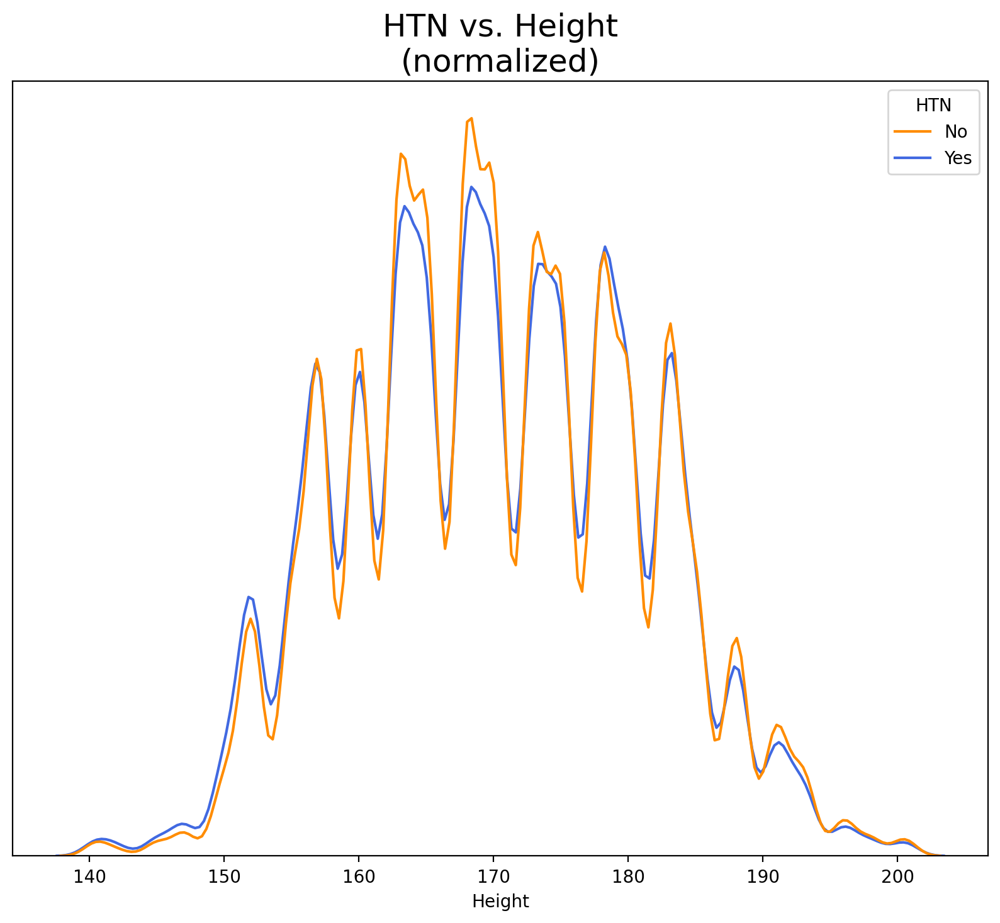

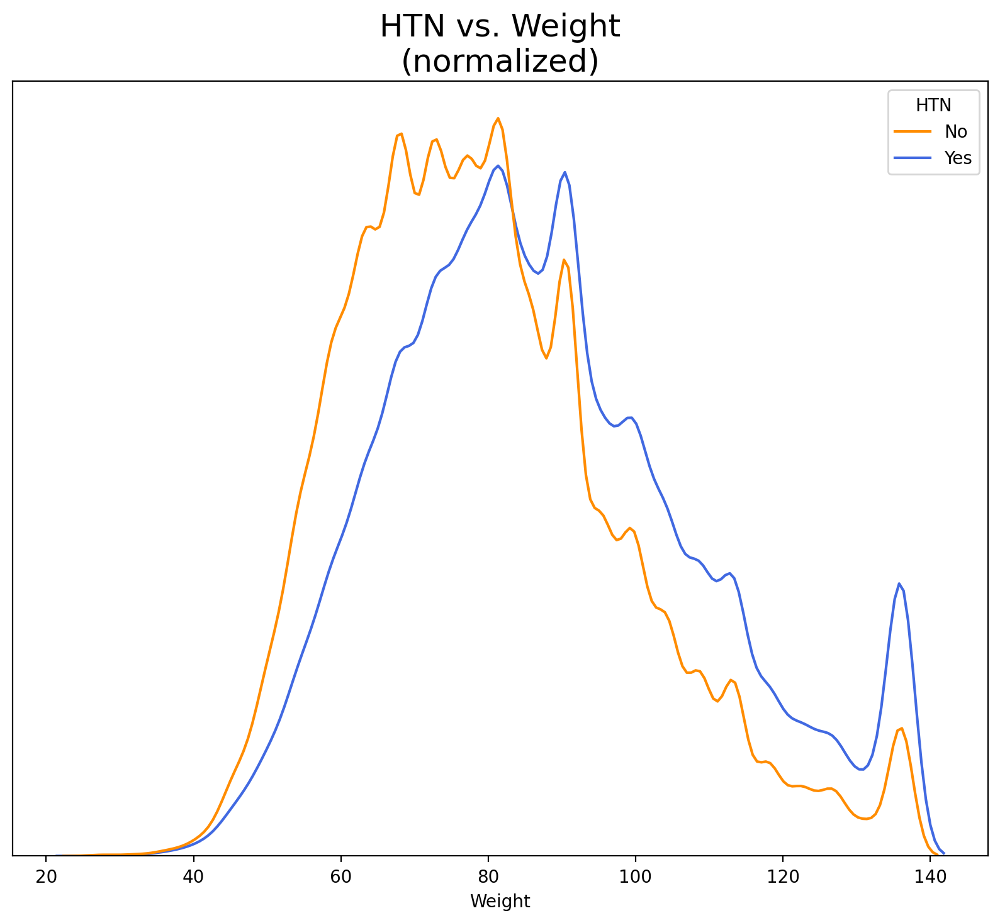

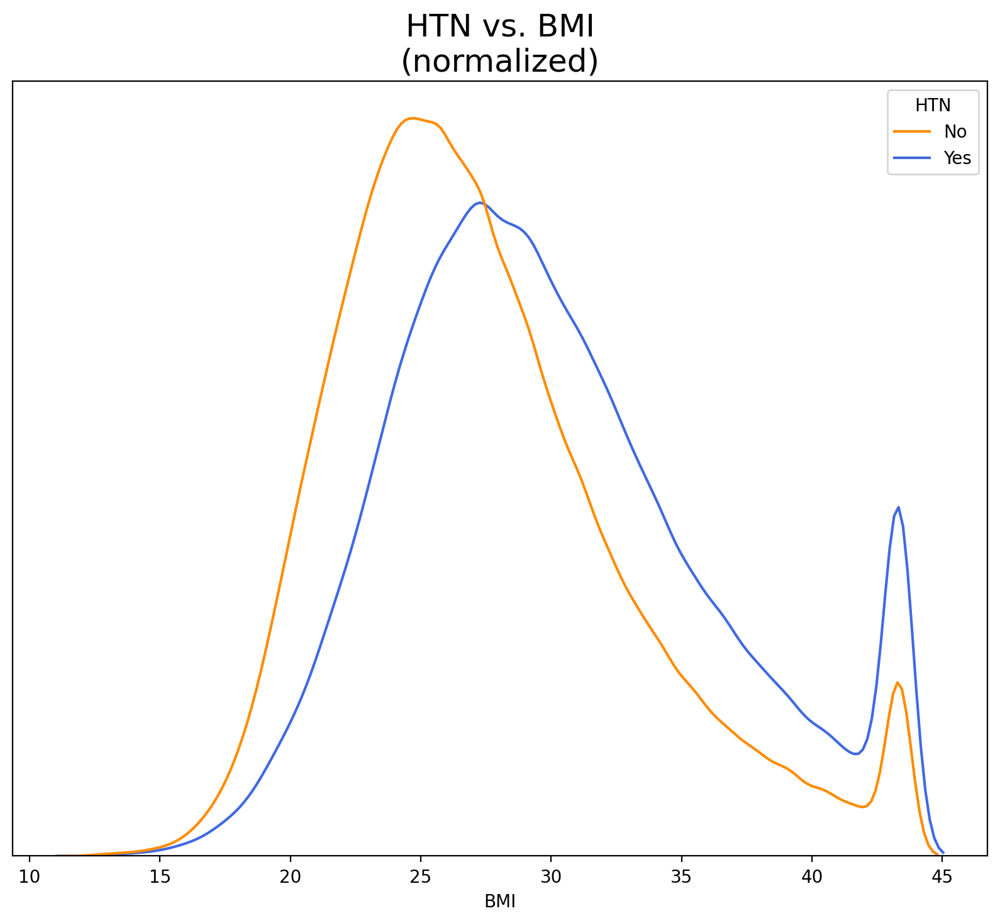

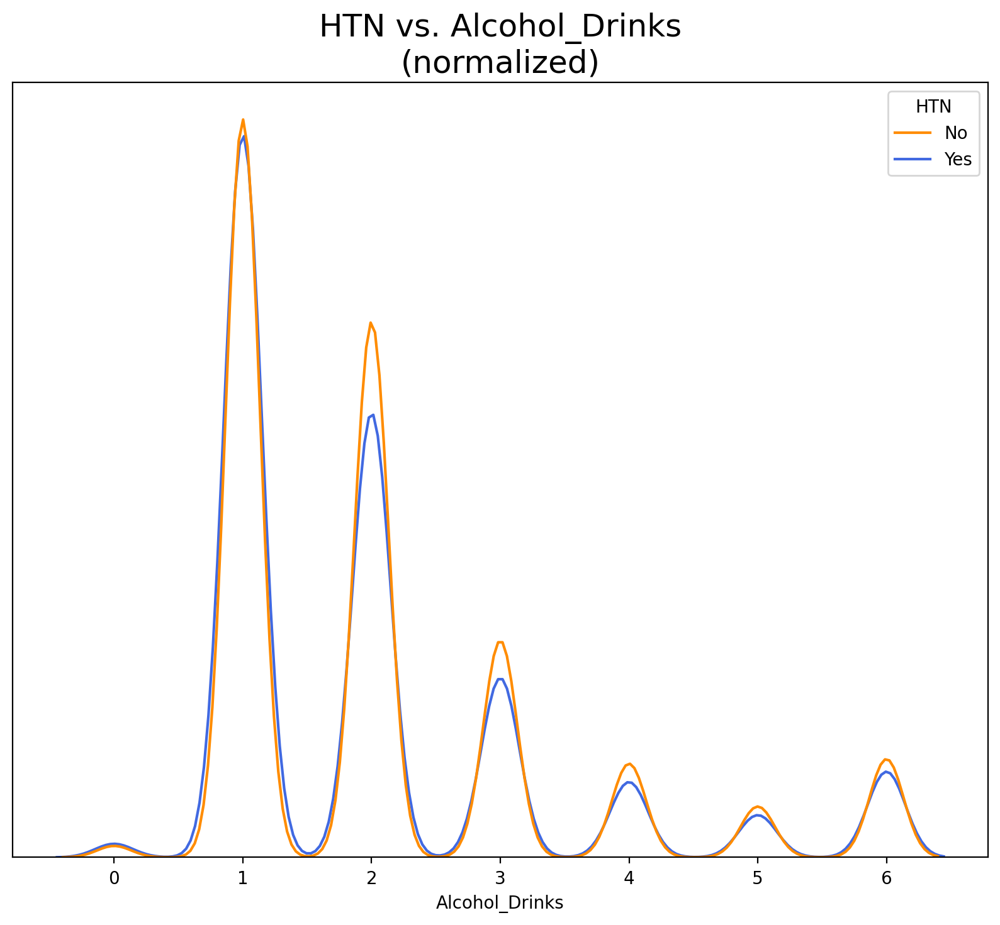

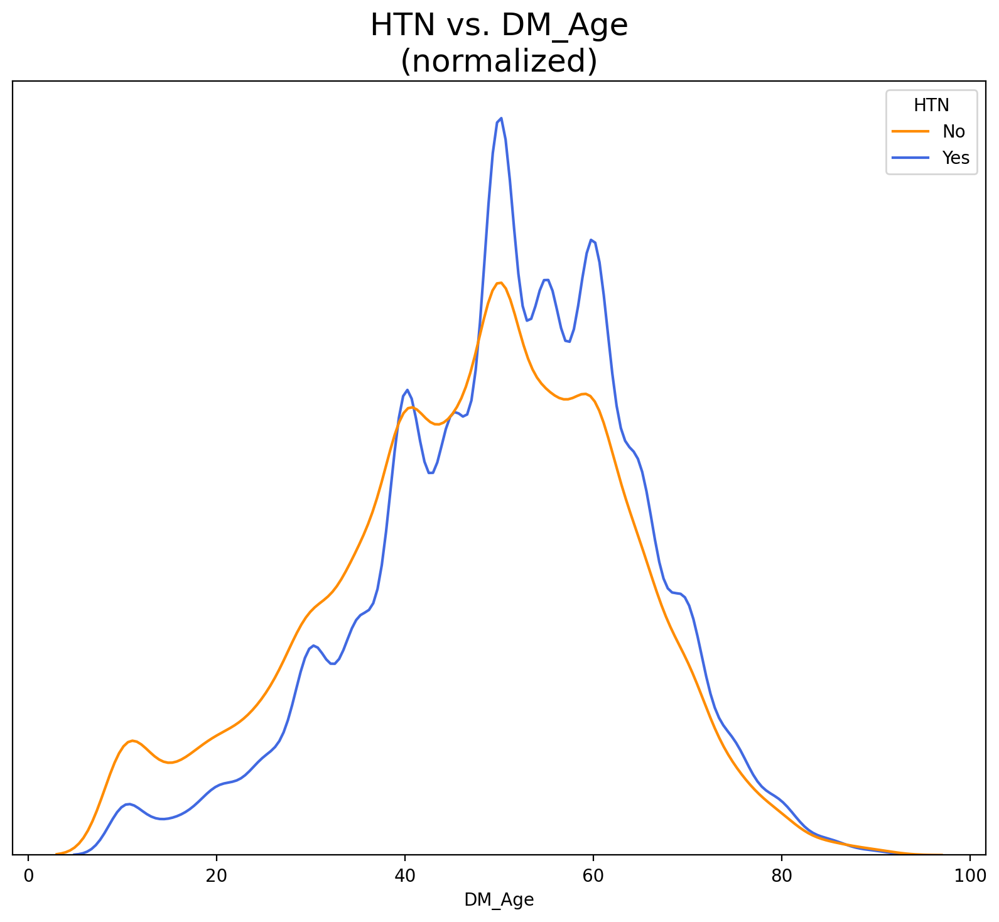

...

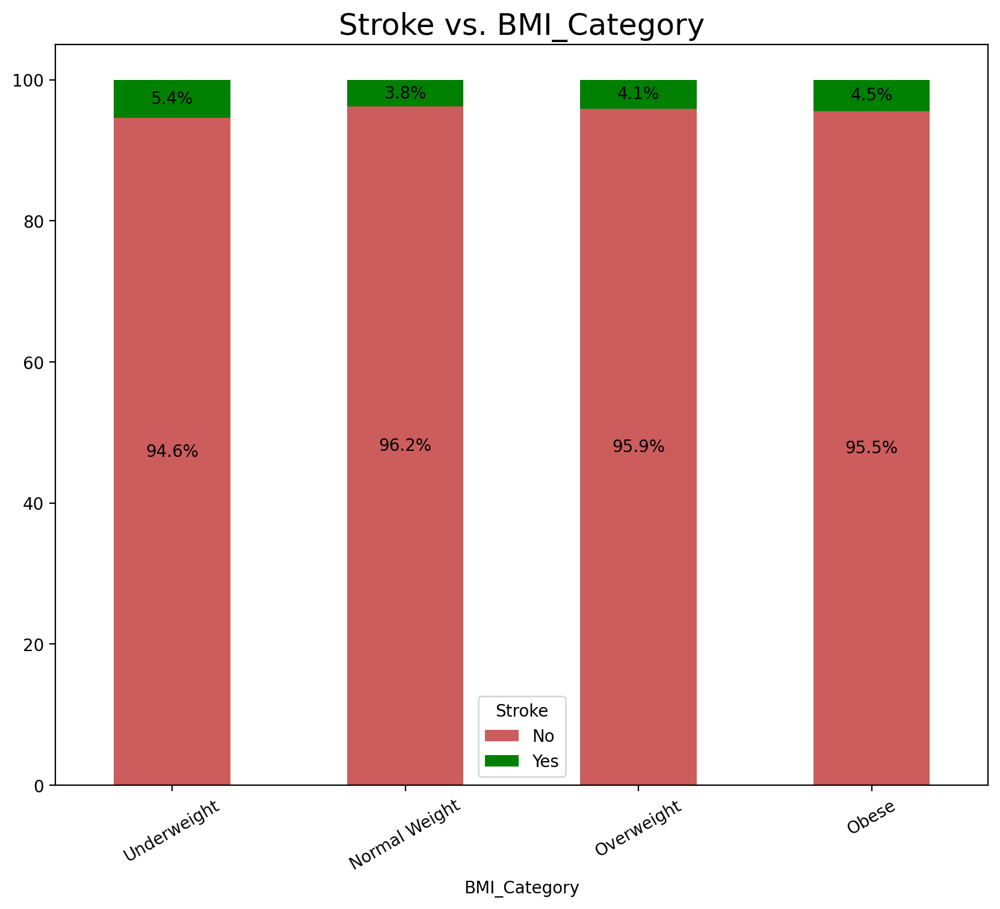

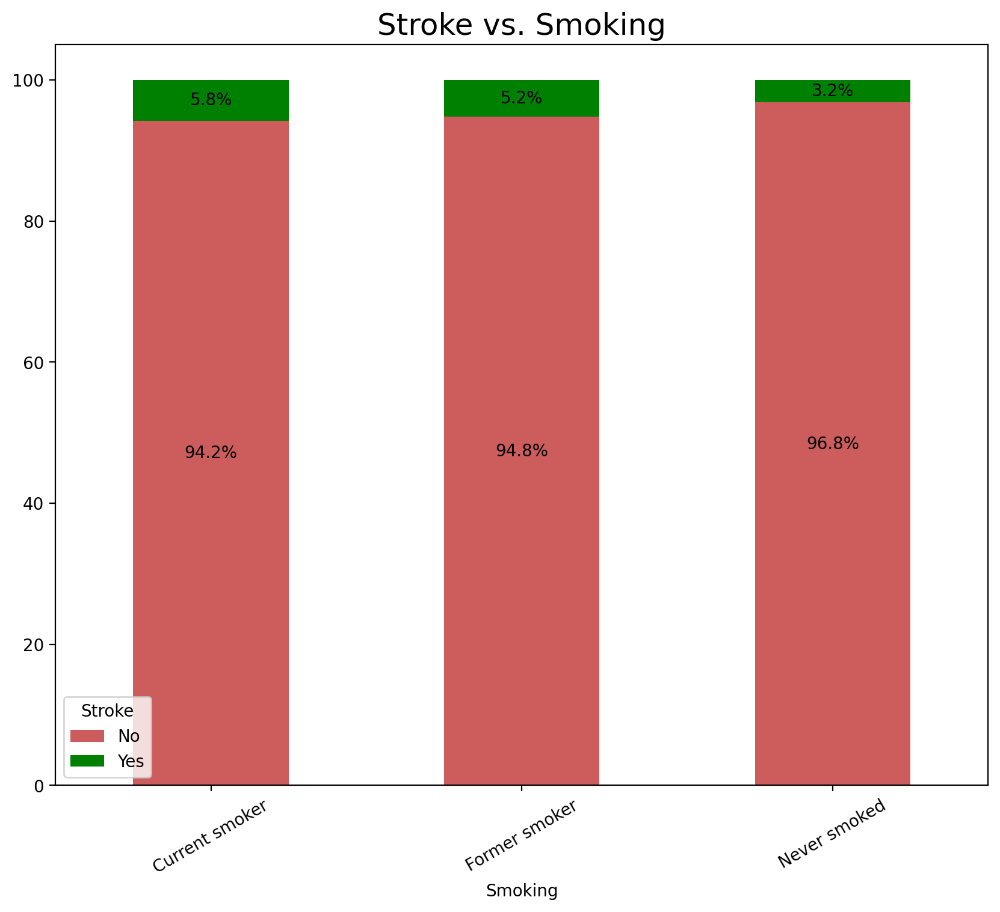

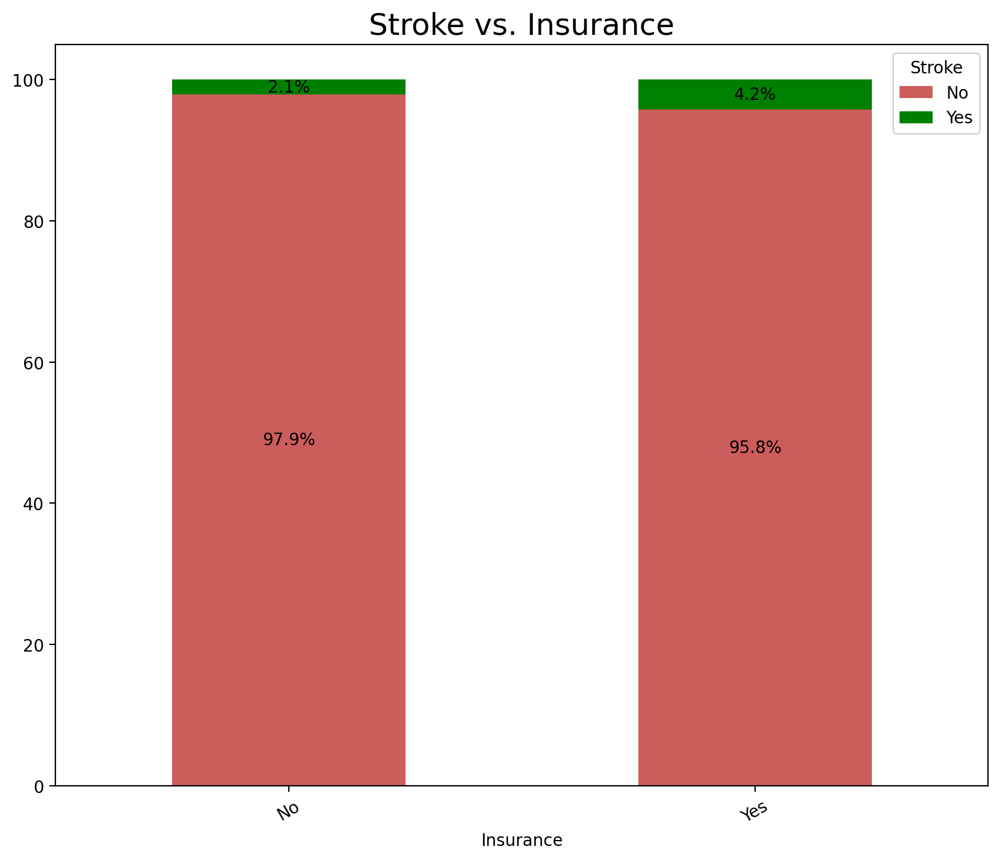

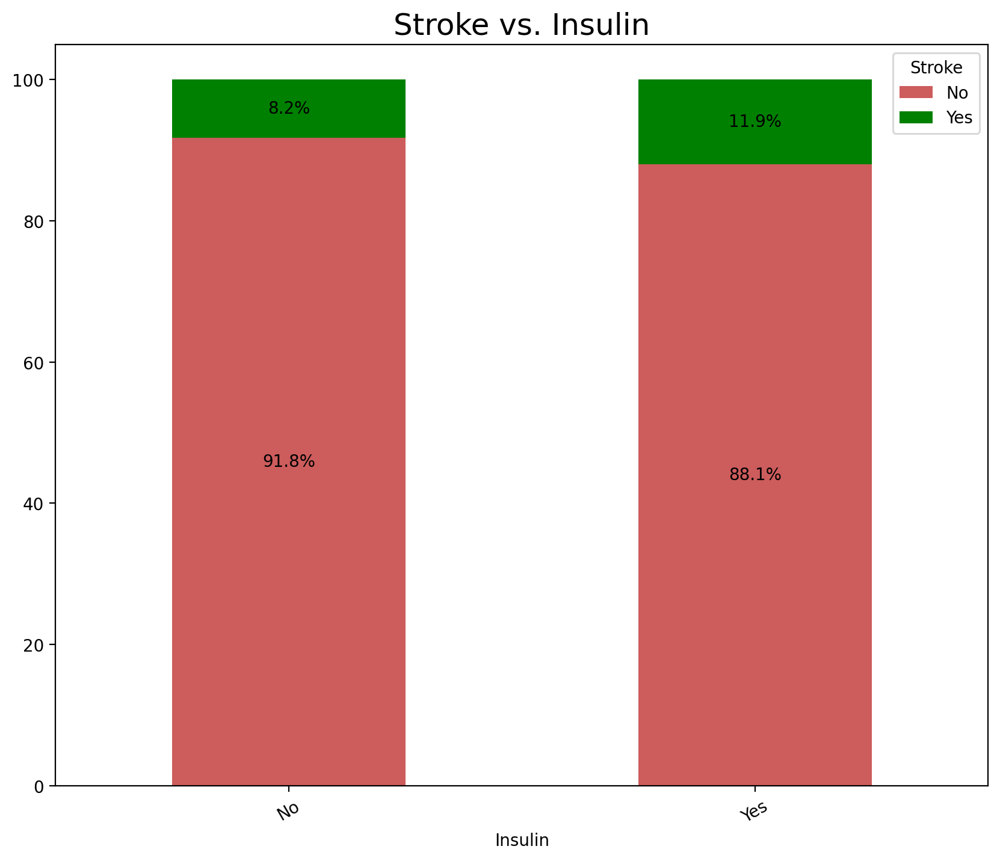

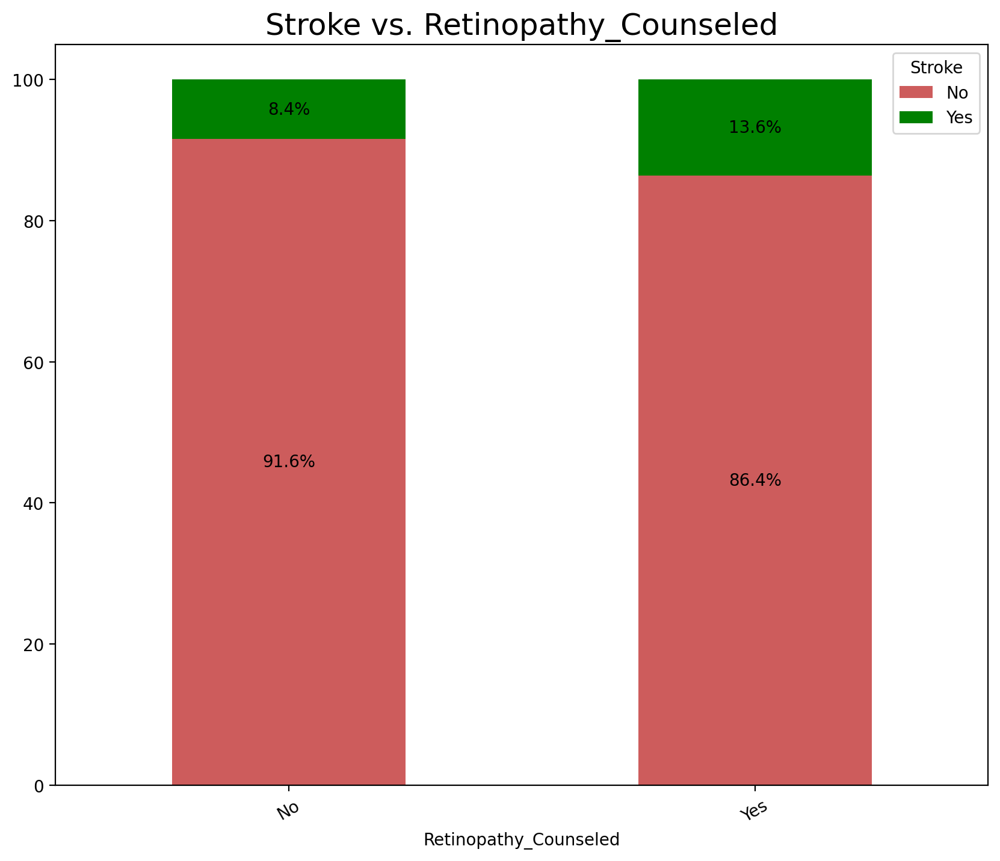

In [6]:
# Plot each disease with the numerical columns against all the other coumns in the dataset to explore it

def diseases_eda():
    for disease in diseases:
        for col in num_vars:
            print('\n\n')
            sns.kdeplot(data=df, x=col, hue=disease, common_norm=False, palette={'Yes':'royalblue', 'No':'darkorange'})\
                .set(title=f"{disease} vs. {col}\n(normalized)", xlabel=col, ylabel=None, yticklabels='')
            plt.tick_params(left=False)
            plt.show();
    
        for col in cat_vars:
            print('\n\n')
            fig, ax = plt.subplots()
            pd.crosstab(df[col], df[disease],  normalize='index').apply(lambda r: r*100)\
                .plot(kind="bar", stacked=True, color=['indianred','green'], ax=ax).set(title=f"{disease} vs. {col}")
            for c in ax.containers:
                ax.bar_label(c, fmt='%.1f%%', label_type='center')
            plt.xticks(rotation=30)
            plt.show();

diseases_eda()

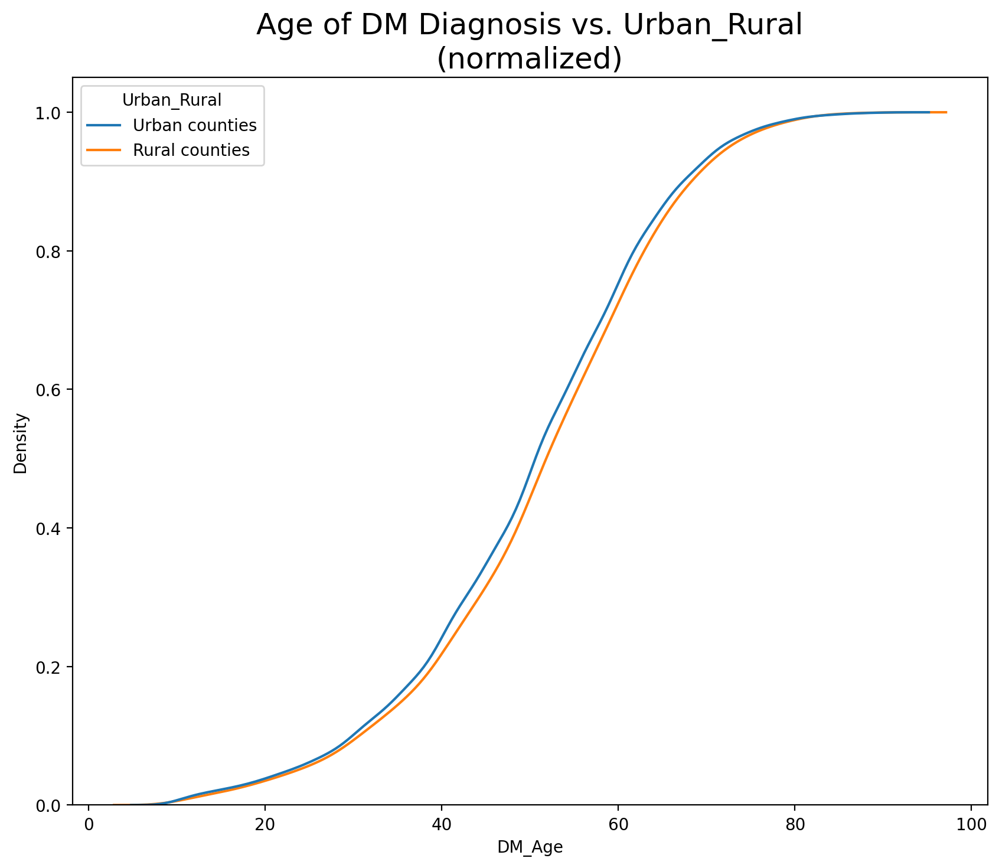

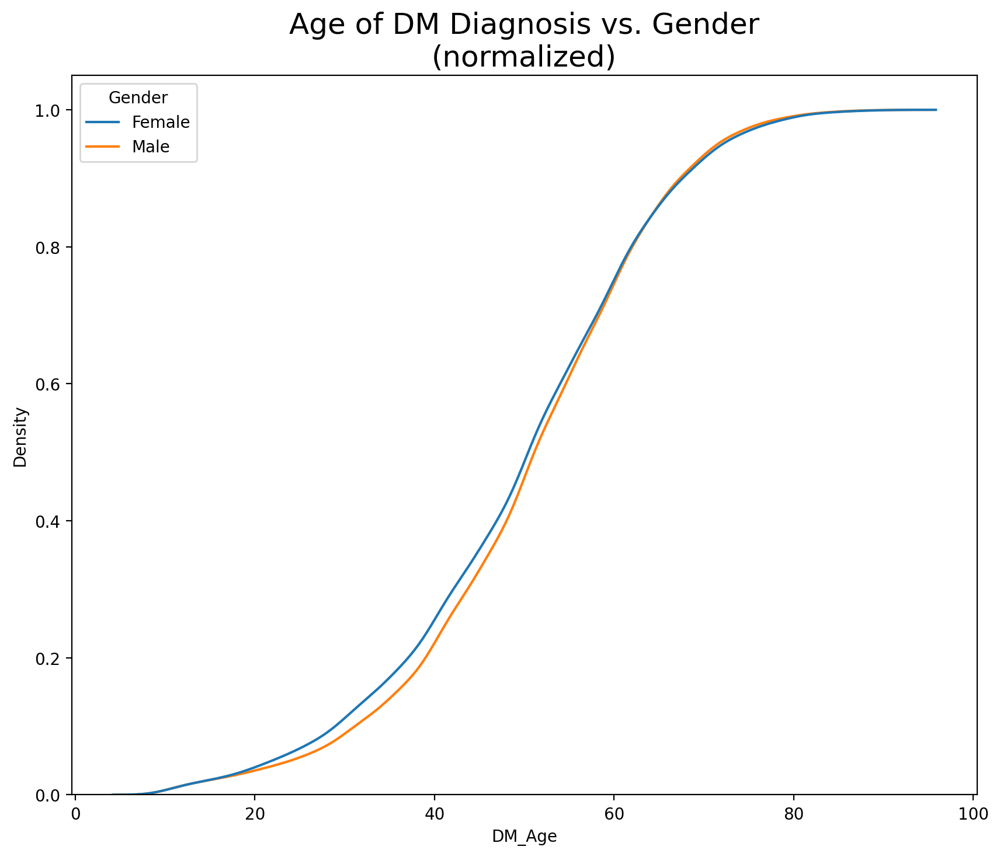

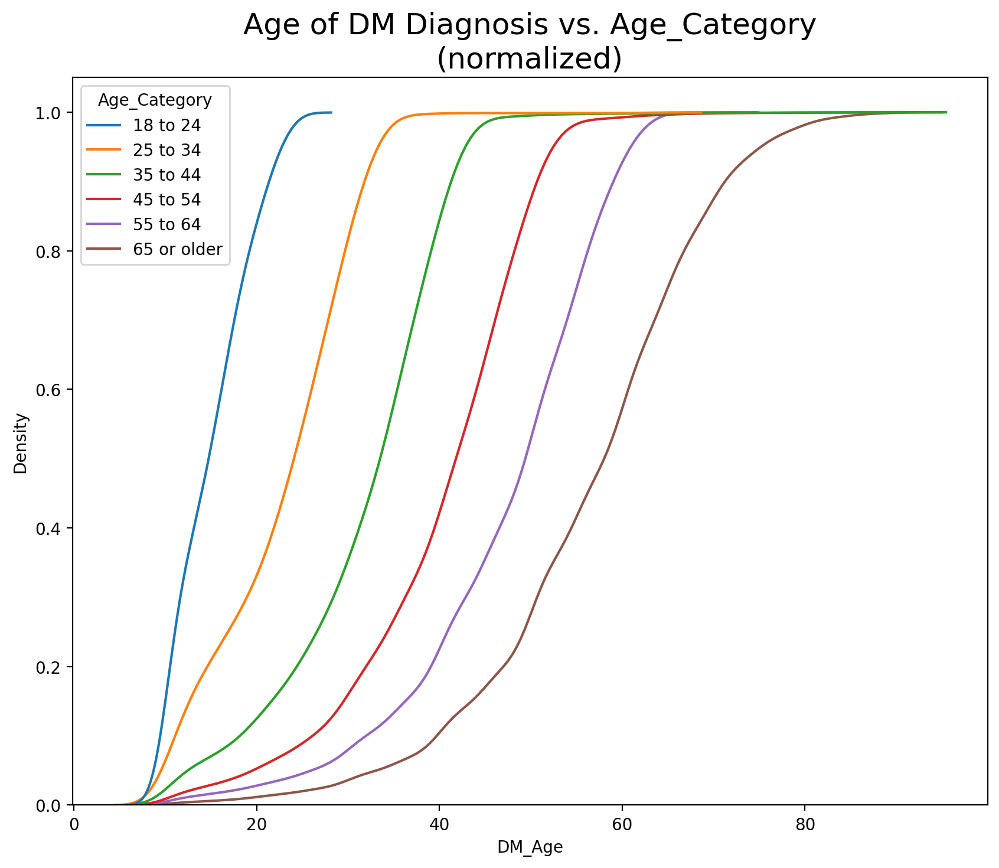

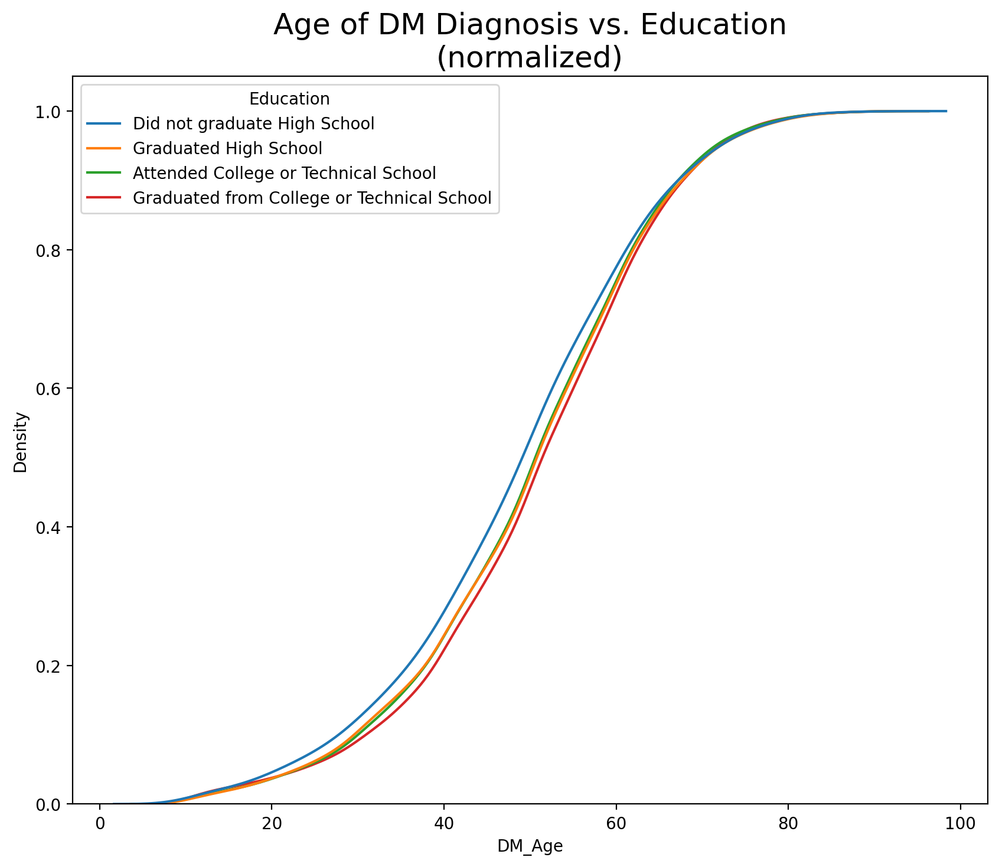

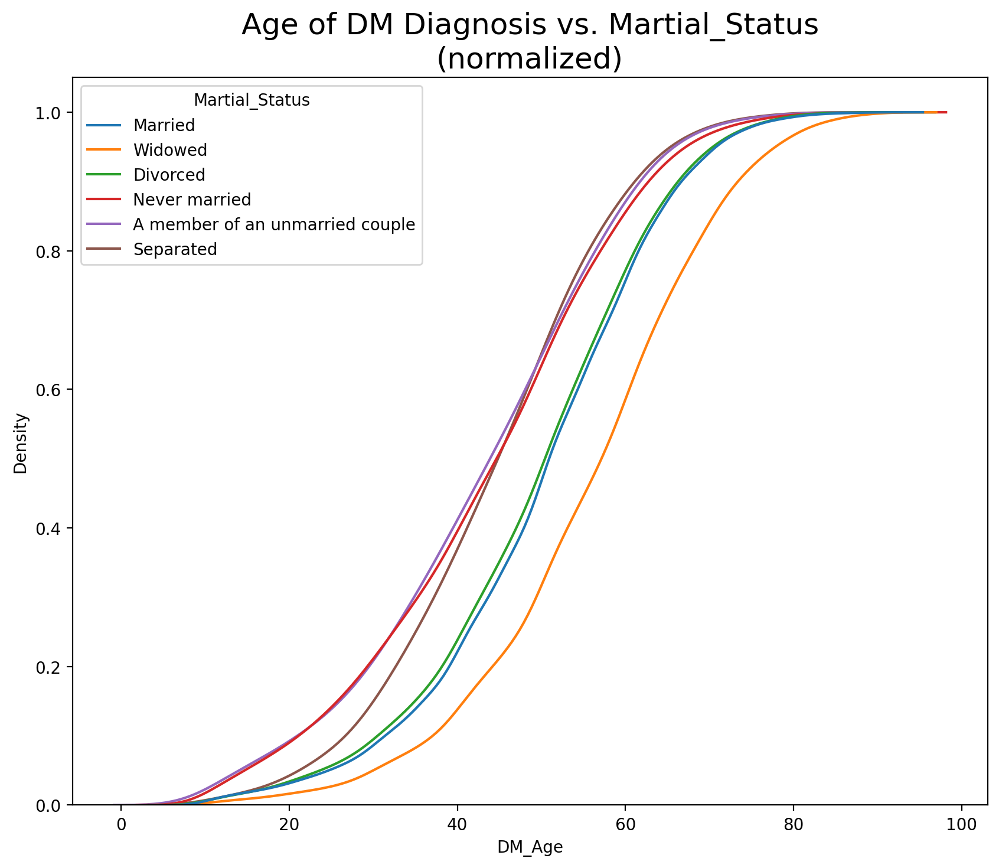

...

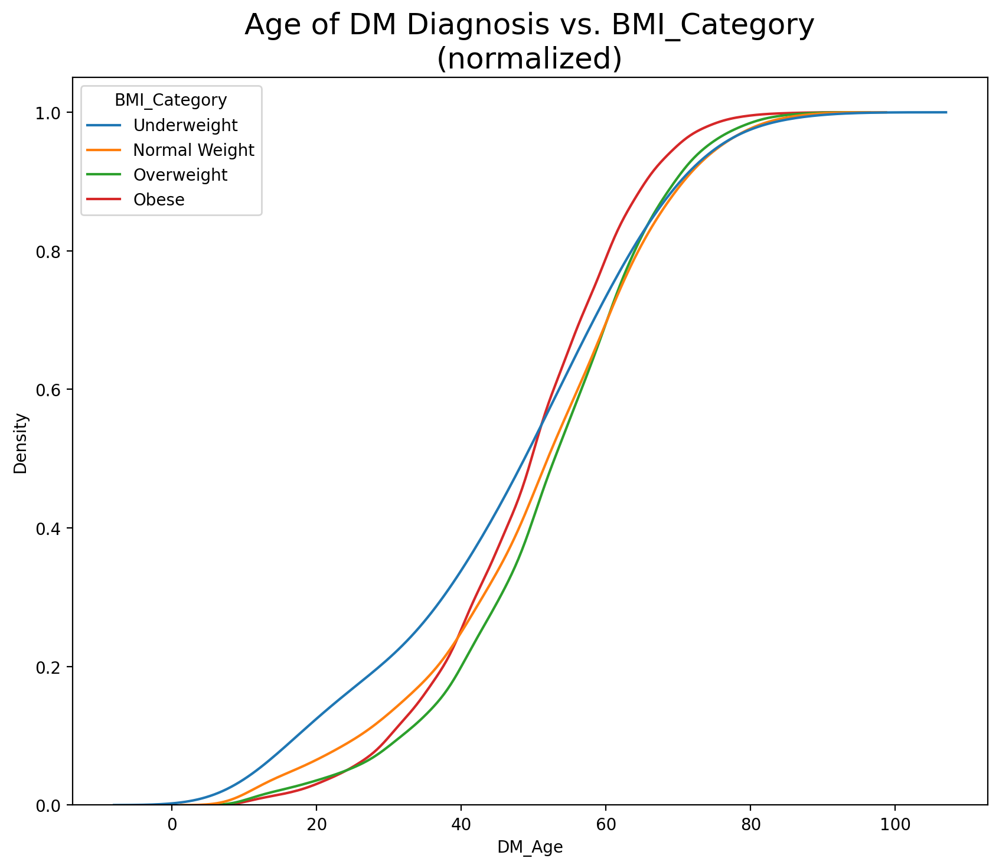

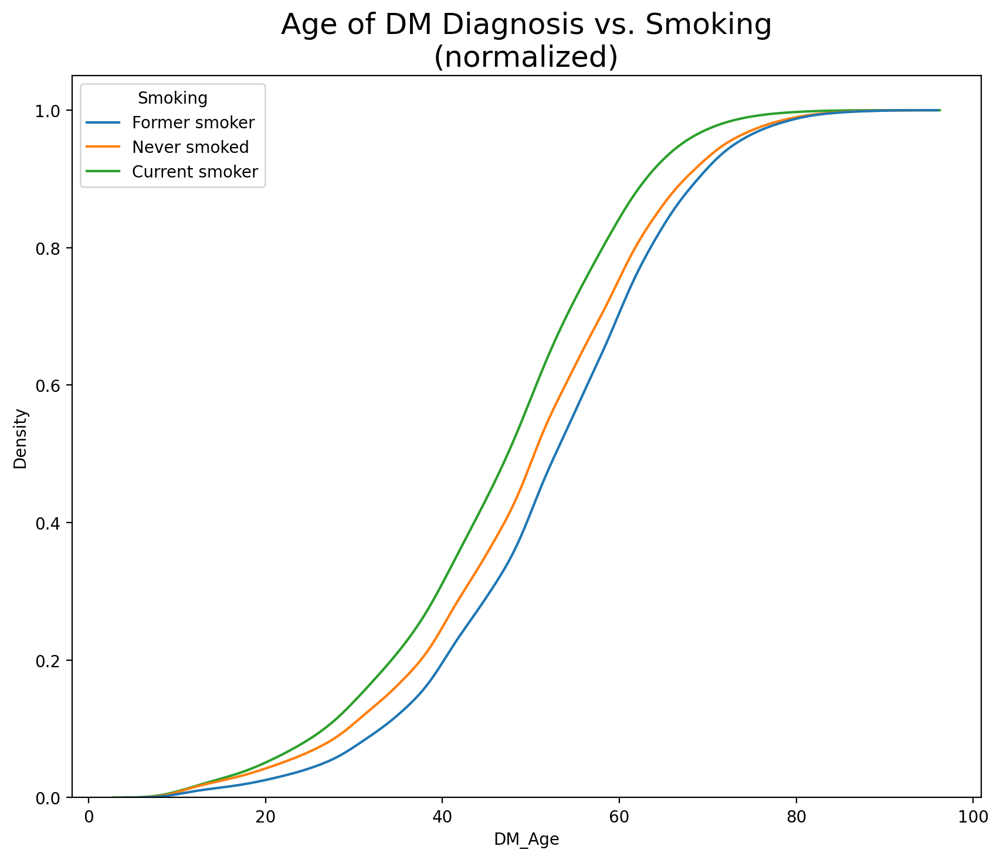

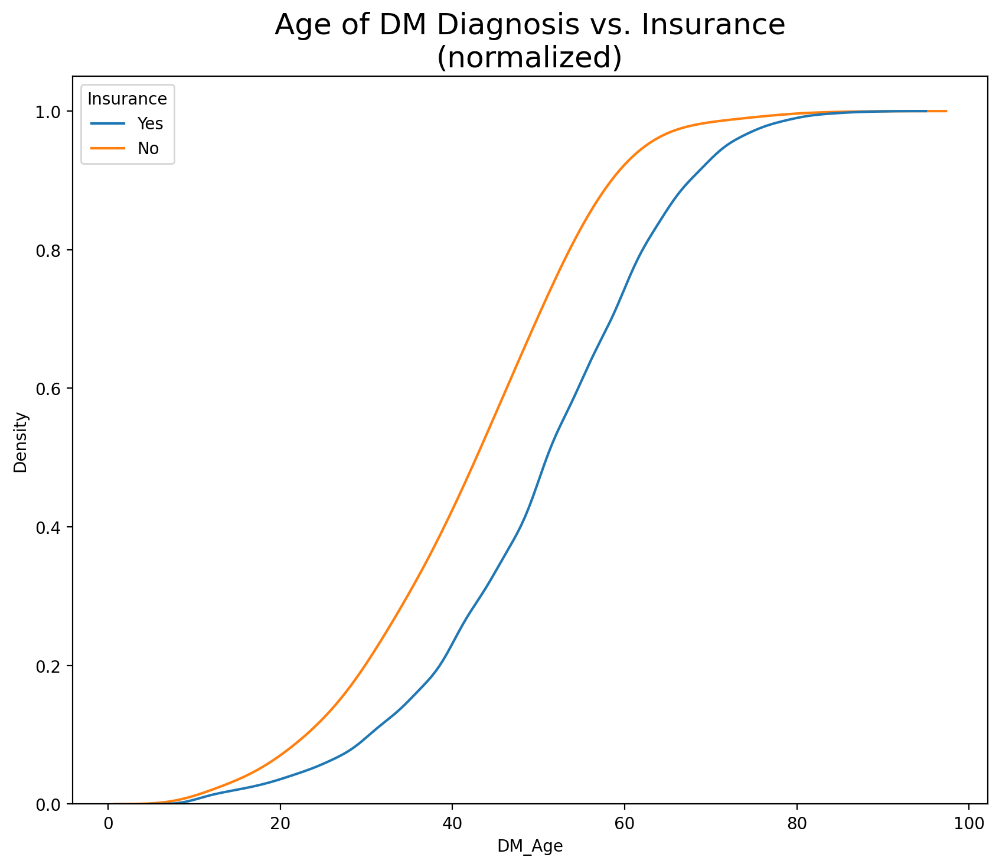

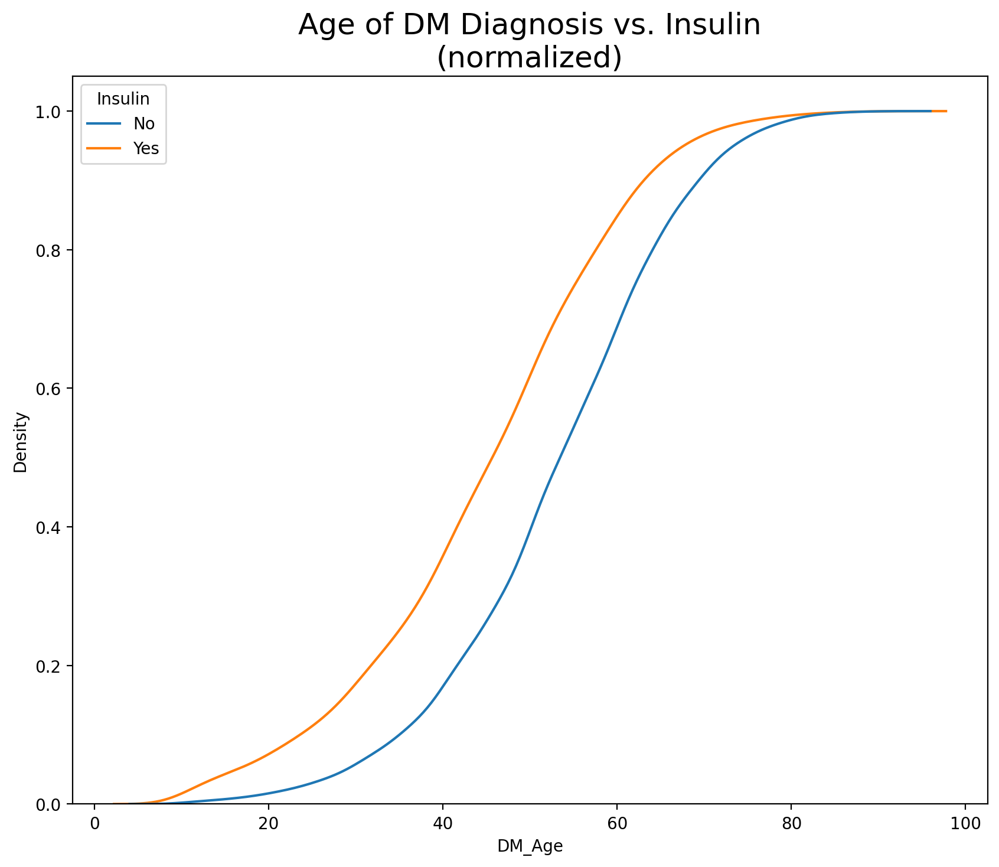

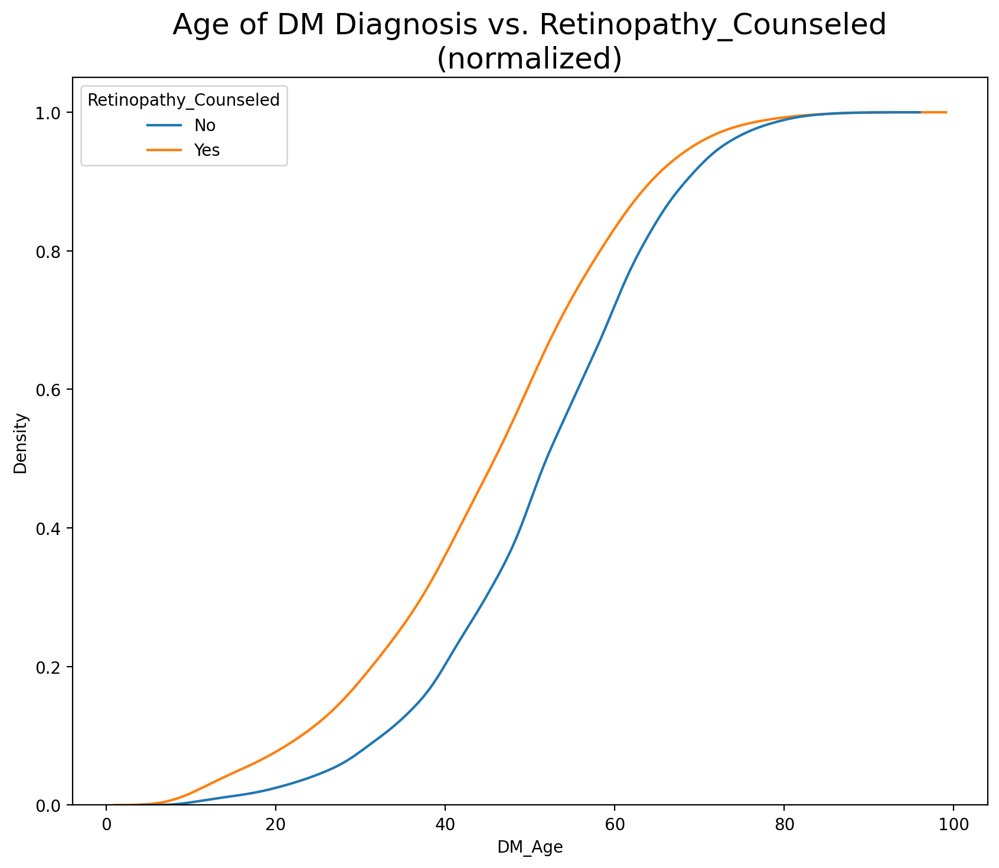

In [7]:
# Plot age of diagnosis of DM against categorical columns

for col in cat_vars:
    sns.kdeplot(data=df, x='DM_Age', hue=col, common_norm=False, cumulative=True)\
        .set(title=f"Age of DM Diagnosis vs. {col}\n(normalized)", xlabel='DM_Age')
    plt.show();

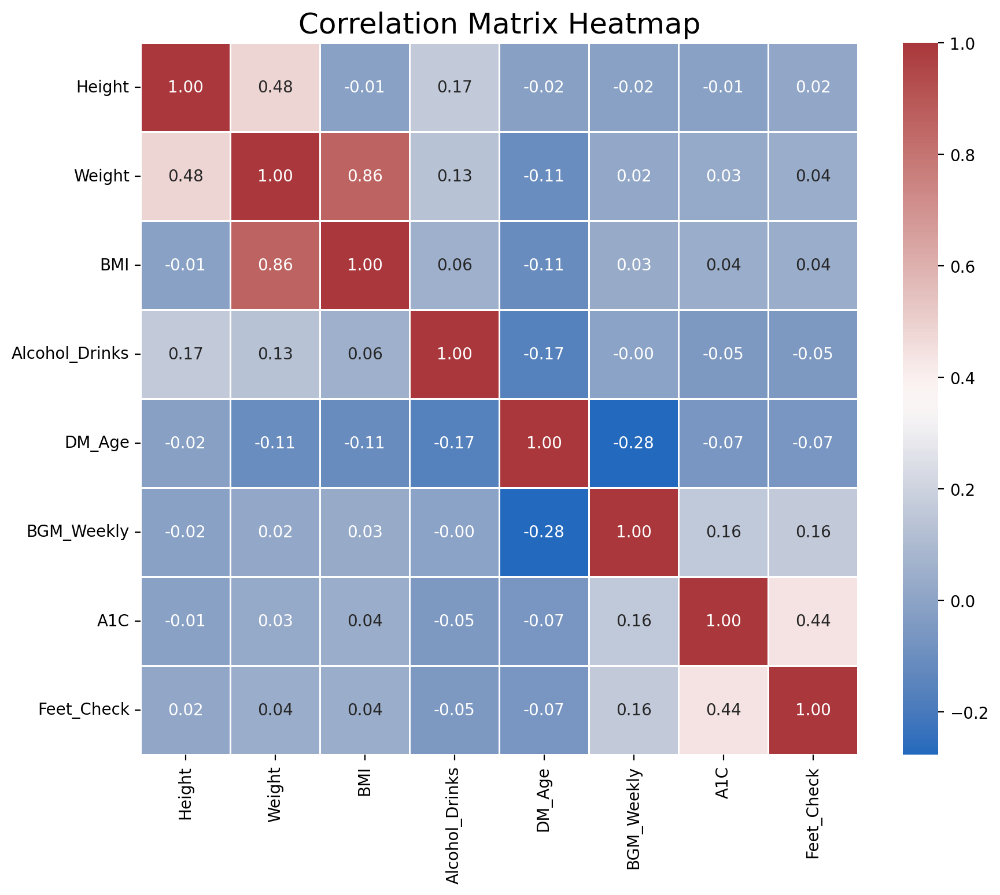

In [8]:
# Plot a correlation heatmap to spot any possible correlations

sns.heatmap(df.corr(), annot=True, linewidth=0.5, fmt='.2f', cmap='vlag')
plt.title('Correlation Matrix Heatmap')
plt.show()

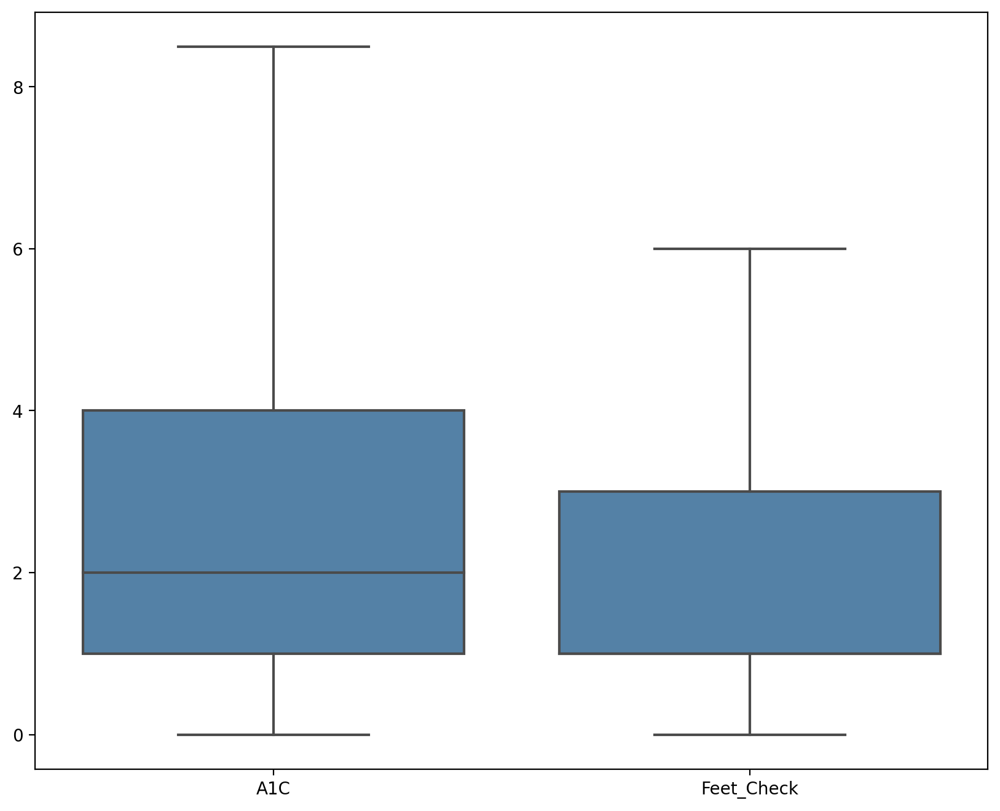

In [9]:
sns.boxplot(data=df[['A1C', 'Feet_Check']], showfliers=False, color='steelblue')
plt.show()

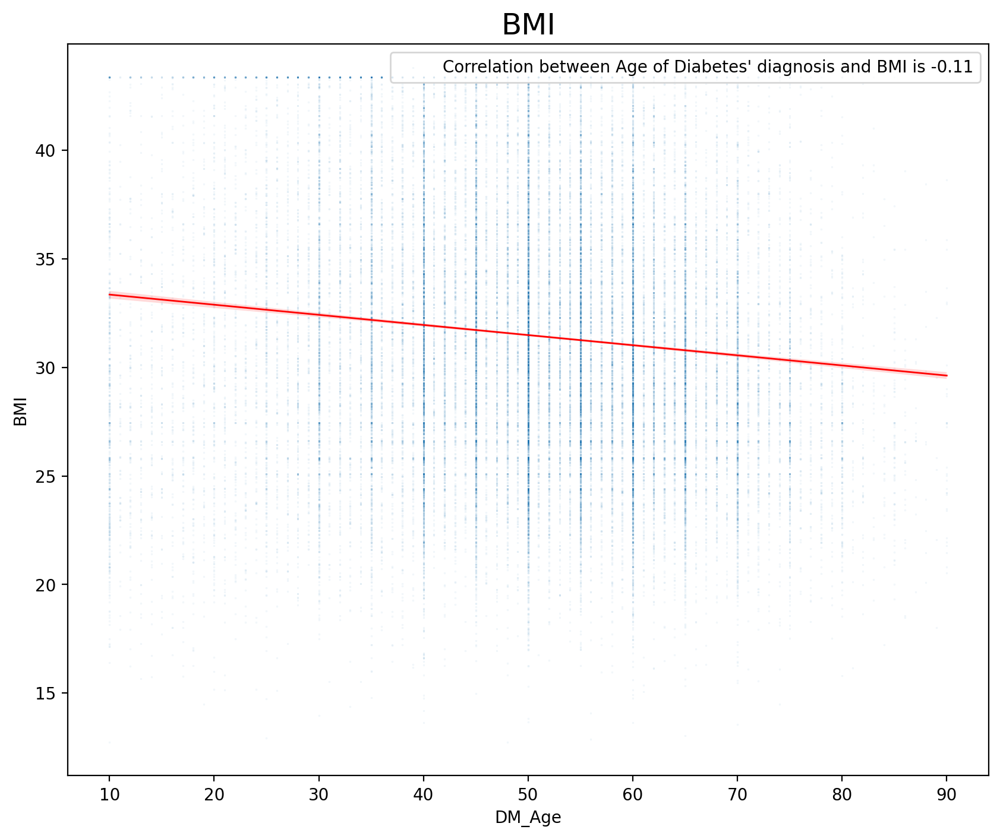

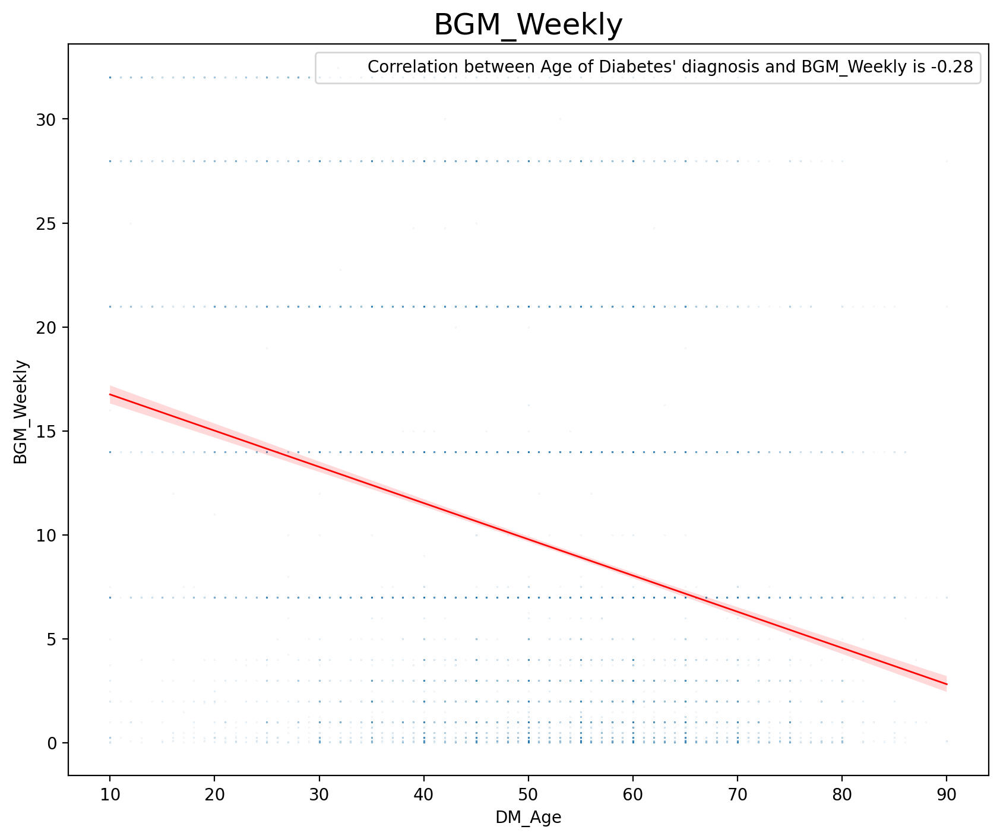

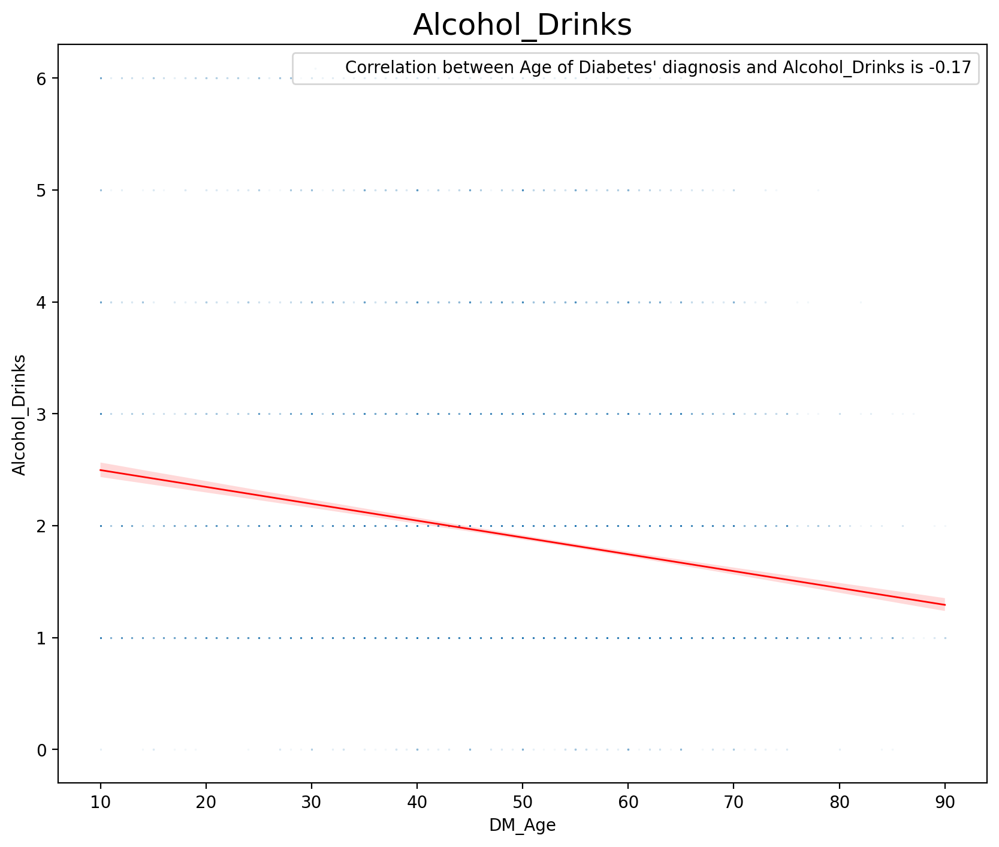

In [10]:
DM_Age_Regplot = ['BMI', 'BGM_Weekly', 'Alcohol_Drinks']

def plot_regplot(dataframe, col):
    sns.regplot(data=dataframe, x='DM_Age', y=col, scatter_kws={'s':0.001}, line_kws={'lw':1, 'color':'red'})
    plt.legend(loc='upper right', labels=[f"Correlation between Age of Diabetes' diagnosis and {col} is {round(dataframe['DM_Age'].corr(dataframe[col]), 2)}"])
    plt.title(f"{col}")
    plt.show()

for col in DM_Age_Regplot:
    print('\n' + '='*100 + '\n')
    plot_regplot(df, col)

In [11]:
# Check to see the percentage of people to have each disease according to different variables

possibilities = pd.DataFrame(columns=['Disease', 'Category', 'Variable','Possibility'])

def get_possibilities(dataframe, disease):
    dataframe = dataframe.dropna(subset=[disease])
    dataframe[disease] = dataframe[disease].str.get_dummies()['Yes']
    for col in cat_vars:
        values = dataframe[col].dropna().unique()
        for value in values:
            possibility = round(dataframe[dataframe[col] == value][disease].mean() * 100, 2)
            possibilities.loc[len(possibilities.index)] = [disease, col, value, possibility]

for disease in diseases:
    get_possibilities(df, disease)
    
possibilities.sample(20)

,Disease,Category,Variable,Possibility
327,MI,Smoking,Former smoker,8.15
298,MI,Age_Category,65 or older,10.12
10,HTN,Education,Graduated High School,44.02
419,Stroke,Retinopathy_Counseled,Yes,13.63
65,DM,Income_Category,"$35,000 to < $50,000",14.76
150,COPD,Income_Category,"0 to $15,000",19.46
238,Kidney_Disease,Veteran,Yes,5.45
233,Kidney_Disease,Income_Category,"$35,000 to < $50,000",4.28
41,HTN,Retinopathy_Counseled,Yes,77.50
109,Asthma,Income_Category,"$100,000 to < $200,000",13.04


# Insights found in this project:<br>

- __HTN:__
    - Factors that seems to increase the probability of being diagnosed with hypertension include: BMI, living in rural area, male gender, less education, less income, being a veteran or former veteran, being a smoker or former smoker, having insurance.
     - Having insurance does not make sense to be a cause for having hypertension. Rather, it makes more sense that some patients with no insurance have undiagnosed hypertension due to the lack of care they might have, which puts them at risk for cardiovascular complications. 
     - As for veterans, combat exposure increases hypertension risk.
<br><br>
- __MI & CHD:__
    - Veterans seems to have almost 2.5 folds more probability to have cardiovascular complications than general population.
<br><br>
- __DM:__
    - Factors that seems to increase the probability of being diagnosed with diabetes include: BMI, living in rural area, male gender, less education, less income, being a veteran or former veteran, being a smoker or former smoker, having insurance.
<br><br>
- __Asthma & COPD:__
     - Asthma is more prevalent in urban areas, while COPD is more prevalent in rural areas.
     - Veterans are more likely to develop COPD.
<br><br>
- __Arthritis:__
    - Factors that seems to increase the probability of being diagnosed with diabetes include: BMI, living in rural area, female gender, having insurance.
    - (almost double)
<br><br>
- __Veterans__:
    - Veterans have an overall rates of hypertension, diabetes, COPD, arthritis, and cardiovascular complications.
<br><br>
- __Insurance:__
    - Having insurance seems to increase the probability of being diagnosed with hypertension, diabetes, or arthritis.
    - This is more likely because patients with no insurance may have undiagnosed diseases due to the lack of healthcare they received, which puts them at risk for further complications. 
<br><br>
- __Age of Diabetes Diagnosis:__
    - Females tend to get diagnosed with DM at slightly lower age compared to males.
    - People who have not graduated from high school tend to get diagnosed with DM at slightly lower age compared to people with higher education. More data is needed to assess other confounding factors that affect this relationship.
    - Veterans tend to be diagnosed with DM at considerably higher age, which could be related to better physical health of veterans.
    - Even though people who do not have insurance have lower chances to get diagnosed with diabetes, but those who do get diagnosed usually do so at lower age, this could be due to the lack of healthcare they could have received with a health insurance, which leads to developing DM at lower age.
    - Patients who get diagnosed with Diabetes at lower age measure their blood glucose at higher rate. Correlation between diagnosis age of DM and number of weekly blood glucose measurements is -0.28, which is weak positive correlation. This could be an indication of better patient counseling given to younger patients, especially those with type-1 DM. Unfortunately, more data is needed for further evaluation.
<br><br>
- __Rural areas:__
    - Rural areas have more prevalence for most diseases surveyed, especially cardiovascular-related diseases. This could be because rural residents often encounter barriers to healthcare that limit their ability to obtain the care they need.
    - The only exceptions were Asthma and Depression. Both of them were more common in Urban areas.
<br><br>
- __Gender:__
    - Males have slightly higher rates of hypertension, with considerably higher chances of cardiovascular complications like Myocardial Infarctions and Congestive Heart Diseases.
    - Females have higher chances of being diagnosed with Depression and with Arthritis compared to males.
<br><br>
- __Other Insights:__
    - Older people tend to have lower chances of being diagnosed with depression.
    - Married people have significantly lower chances of being diagnosed with depression compared to people with other martial status.
    - Those who have completed their college or technical school seems to be less likely to be diagnosed with any of the diseases mentioned in this survey. This is more likely due to the increases health awareness they possess due to their education.
    - As income increases, chances of being diagnosed with any of the diseases mentioned in this survey decreases. This is likely due to the better healthcare they receive which cost more money.
    - Obese people generally have higher chances of being diagnosed with any of the diseases mentioned in this survey.
    - Those who never smoked have significantly lower chances of being diagnosed with any of the diseases mentioned in this survey compared to both current and former smokers. The difference in COPD is staggering.